*Project Aim:*

Advanced Market Basket Analysis and Geospatial Data Integration for U.S. Online Retail

__Step 1: Load and Clean the Data__

Using Python's pandas package, I'm working on data cleansing chores. I started by reading some basic dataset information from a CSV file called "sales.csv" into a DataFrame called "data." My next step involved cleansing the data by eliminating duplicates and rows with null values. The quantity of null and duplicate rows in each column was among the details I printed about the cleaned DataFrame after cleaning.

In [5]:

import pandas as pd

data=pd.read_csv('sales.csv')
print(data.info())
# Print initial information about the dataset
print(data.info())

# Clean the data
# Remove rows with Null values
data = data.dropna()

# Remove duplicate rows
data = data.drop_duplicates()

# Check the information of the cleaned dataframe
print(data.info())

# Test cell to print the number of null and duplicate rows
nodata_count = data.isnull().sum()
duplicate_count = data.duplicated().sum()

print(f'Number of no-data values in each column:\n {nodata_count} \n')
print(f'Number of duplicate values in each column: {duplicate_count}')


C:\Users\Adhitya\AppData\Local\Temp\ipykernel_37436\1961069856.py:3: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data=pd.read_csv('sales.csv')


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 429588 entries, 0 to 429587
Data columns (total 16 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   order_id        429588 non-null  object 
 1   order_date      429588 non-null  object 
 2   status          429588 non-null  object 
 3   price           429588 non-null  float64
 4   category        429588 non-null  object 
 5   payment_method  429588 non-null  object 
 6   cust_id         429588 non-null  int64  
 7   Name Prefix     429588 non-null  object 
 8   Gender          429588 non-null  object 
 9   age             429588 non-null  int64  
 10  County          429588 non-null  object 
 11  City            429588 non-null  object 
 12  Zip             429588 non-null  int64  
 13  Region          429588 non-null  object 
 14  Latitude        415283 non-null  float64
 15  Longitude       415283 non-null  float64
dtypes: float64(3), int64(3), object(10)
memory usage: 52.4+ 

In [6]:
data.head()

,order_id,order_date,status,price,category,payment_method,cust_id,Name Prefix,Gender,age,County,City,Zip,Region,Latitude,Longitude
0,100354678,2020-10-01,received,89.9,Men's Fashion,cod,60124,Drs.,F,43,Harmon,Vinson,73571,South,34.9325,-99.92476
1,100354678,2020-10-01,received,19.0,Men's Fashion,cod,60124,Drs.,F,43,Harmon,Vinson,73571,South,34.9325,-99.92476
2,100354680,2020-10-01,complete,149.9,Men's Fashion,cod,60124,Drs.,F,43,Harmon,Vinson,73571,South,34.9325,-99.92476
3,100354680,2020-10-01,complete,79.9,Men's Fashion,cod,60124,Drs.,F,43,Harmon,Vinson,73571,South,34.9325,-99.92476
4,100367357,2020-11-13,received,99.9,Men's Fashion,cod,60124,Drs.,F,43,Harmon,Vinson,73571,South,34.9325,-99.92476


__Step 2: Find the Most Popular Product Categories__


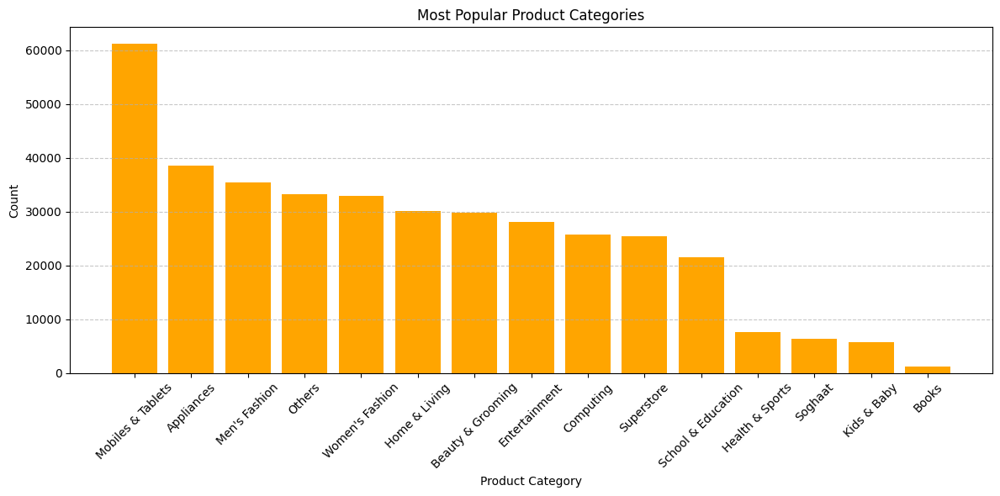

In [7]:
# Import necessary packages for visualization
import matplotlib.pyplot as plt

# Group the data by the product category and get the count of each category
category_counts = data.groupby('category').size()

# Create a new dataframe from the category counts
category_df = pd.DataFrame({'category': category_counts.index, 'count': category_counts.values})

# Sort the dataframe by the count in descending order
category_df = category_df.sort_values('count', ascending=False)

# Plotting the bar chart
plt.figure(figsize=(12, 6))
plt.bar(category_df['category'], category_df['count'], color='orange')
plt.xlabel('Product Category')
plt.ylabel('Count')
plt.title('Most Popular Product Categories')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


In this code, I'm using Python with pandas and matplotlib to analyze and visualize data from a sales dataset. The first part of the code involves loading the sales data from a CSV file into a pandas DataFrame, cleaning the data by removing rows with null values and duplicates, and then printing information about the cleaned DataFrame.

Next, I group the data by the product category and count the occurrences of each category. This grouped data is then transformed into a new DataFrame to facilitate plotting. I sort this new DataFrame by the count of each category in descending order to identify the most popular product categories.

For visualization, I create a bar chart using matplotlib. The x-axis of the chart represents the product categories, while the y-axis represents the count of each category. The chart is styled with a specific color scheme, labels for axes and title, rotated x-axis labels for better readability, grid lines for better visualization, and a tight layout to ensure all elements are properly displayed.

Overall, this code helps me gain insights into the most popular product categories based on sales data and presents the information in a clear and visually appealing manner using a bar chart.

__Step 3: Customer Distribution by Region__


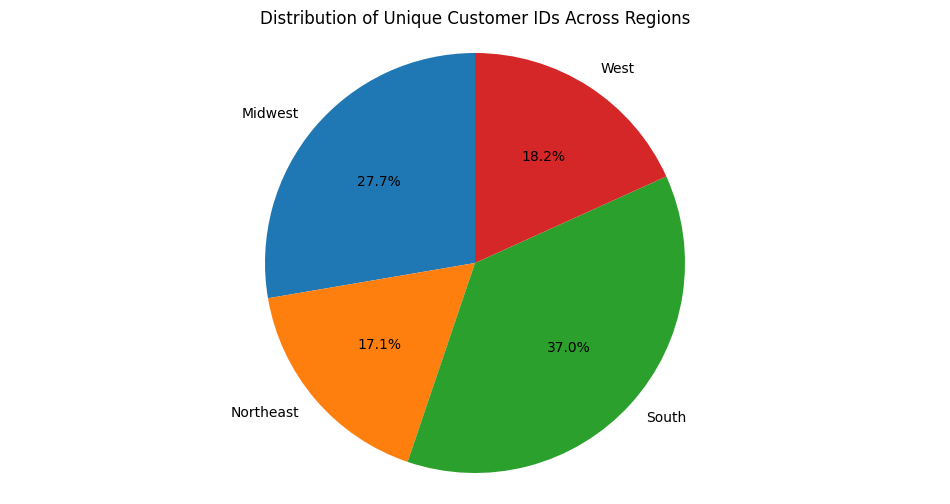

In [8]:
# Import necessary packages for visualization
import matplotlib.pyplot as plt

# Group the data by region and count the unique customer IDs
region_customers = data.groupby('Region')['cust_id'].nunique()

# Plotting the pie chart
plt.figure(figsize=(12, 6))
region_customers.plot(kind='pie', autopct='%1.1f%%', startangle=90, colors=plt.cm.tab10.colors)
plt.title('Distribution of Unique Customer IDs Across Regions')
plt.ylabel('')  # Remove y-label
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle
plt.show()


I'm using Python's matplotlib library to visualize data related to customer distribution across different regions. First, I group the data by the 'Region' column and count the number of unique customer IDs in each region.

Next, I create a pie chart to represent the distribution of unique customer IDs across regions. The chart is customized with a figure size of 12x6 inches for better visibility. Each slice represents a region, and its size corresponds to the percentage of unique customer IDs in that region relative to the total. The autopct='%1.1f%%' parameter displays the percentage values on each slice with one decimal place. I set the startangle to 90 degrees to rotate the chart starting position and use a color palette from plt.cm.tab10.colors for the slices.

The chart is titled 'Distribution of Unique Customer IDs Across Regions' for clarity. I remove the y-label (plt.ylabel('')) as it's not necessary for a pie chart and use plt.axis('equal') to ensure the chart is drawn with an equal aspect ratio, making it a perfect circle.

This visualization provides a clear overview of how unique customer IDs are distributed among different regions, making it easier to understand the customer distribution patterns across geographical areas.

__Step 4: Market Basket Analysis with Apriori Algorithm__


In [9]:
# Import necessary packages for Apriori
from mlxtend.preprocessing import TransactionEncoder
from mlxtend.frequent_patterns import apriori

# Group by 'order_id' and collect categories into lists
transactions = data.groupby('order_id')['category'].apply(list).values.tolist()

# Initialize and fit the transaction encoder
te = TransactionEncoder()
te_ary = te.fit(transactions).transform(transactions)

# Convert encoded transactions to a DataFrame
df_encoded = pd.DataFrame(te_ary, columns=te.columns_)

# Apply Apriori algorithm
min_support = 0.2  # Adjust this value for different support thresholds
frequent_itemsets = apriori(df_encoded, min_support=min_support, use_colnames=True)

# Print the frequent itemsets
print(frequent_itemsets.sort_values(by='support', ascending=False))


    support             itemsets
0  0.228894  (Mobiles & Tablets)


I'm using mlxtend library to analyze transaction data using the Apriori algorithm. First, I group the data by 'order_id' and collect the categories into lists for each order.

Next, I convert these lists into a format that Apriori can work with using TransactionEncoder. This step helps Apriori understand the relationships between different categories in the transactions.

Using the Apriori algorithm with a specified minimum support threshold, I identify sets of categories that frequently occur together in the transactions.

The results, sorted by support level, provide insights into which categories tend to be bought together, aiding in understanding customer buying patterns and potential recommendations based on these patterns

__Step 5: Generate Association Rules__


In [11]:
# Import necessary packages for association rules
from mlxtend.frequent_patterns import association_rules

# Generate association rules with a minimum confidence threshold of 0.5
rules = association_rules(frequent_itemsets, metric="confidence", min_threshold=0.5)

# Display the generated rules
print(rules)


Empty DataFrame
Columns: [antecedents, consequents, antecedent support, consequent support, support, confidence, lift, leverage, conviction, zhangs_metric]
Index: []


Using the mlxtend library's association_rules function, I generate association rules based on the frequent itemsets previously obtained from the Apriori algorithm.

In this code snippet, I set a minimum confidence threshold of 0.5, which means that only rules with a confidence level of 50% or higher will be generated.

The generated rules are then displayed using the print function, providing insights into the relationships and dependencies between different categories in the dataset based on the specified confidence threshold.

__Step 6: Load US State Boundary Shape Files__


In [13]:
# Import necessary packages for GeoPandas
import geopandas as gpd

# Load the US boundary shape file into a GeoDataFrame
us_states = gpd.read_file('us_state.shp')
print(us_states)


   STUSPS                                          NAME  \
0      HI                                        Hawaii   
1      AR                                      Arkansas   
2      NM                                    New Mexico   
3      MT                                       Montana   
4      NY                                      New York   
5      ND                                  North Dakota   
6      SD                                  South Dakota   
7      UT                                          Utah   
8      OR                                        Oregon   
9      WA                                    Washington   
10     AS                                American Samoa   
11     ID                                         Idaho   
12     MP  Commonwealth of the Northern Mariana Islands   
13     PR                                   Puerto Rico   
14     OK                                      Oklahoma   
15     NJ                                    New Jersey 

I'm using the GeoPandas library in Python to work with geospatial data. First, I import the necessary package as 'gpd'.

Then, I load a shapefile containing the boundary shapes of US states into a GeoDataFrame using the read_file function from GeoPandas. The shapefile is typically named 'us_state.shp' and contains geographical information about each state.

Finally, I print the GeoDataFrame to view the loaded data, which includes the geometry (boundary shapes) of each state along with any additional attributes present in the shapefile. This allows for spatial analysis and visualization of the US state boundaries using GeoPandas.

__Step 7: Show Customer Locations on Folium Map__


In [14]:
# Import necessary packages for Folium
import folium
from folium.plugins import MarkerCluster
from folium import GeoJson

# Create a map
m = folium.Map(location=[37, -102], zoom_start=5)

# Add US states to the map
GeoJson(us_states).add_to(m)

# Add points to the map using MarkerCluster
marker_cluster = MarkerCluster().add_to(m)

# Get the first 2000 unique customer locations
unique_customers = data.drop_duplicates(subset='cust_id').iloc[:2000]

# Add customer markers to the map
for _, row in unique_customers.iterrows():
    if not pd.isnull(row['Latitude']) and not pd.isnull(row['Longitude']):
        folium.Marker(location=[row['Latitude'], row['Longitude']]).add_to(marker_cluster)

# Display the map
m


I'm using Folium, a Python library for interactive maps. First, I import the necessary packages like folium, MarkerCluster, and GeoJson. Then, I create a base map centered around the United States with an initial zoom level using the folium.Map function. I add the US state boundaries to this map using GeoJson, which allows me to visualize the state geometries. To improve the map's organization, I use MarkerCluster to group customer markers efficiently. Next, I select the first 2000 unique customer locations from the dataset and plot them as markers on the map. I ensure that only locations with valid latitude and longitude values are considered for plotting. Finally, I display the interactive map, allowing me to explore US state boundaries and the distribution of customer locations by zooming in, zooming out, and panning across the map.

__Step 8: Spatial Filtering Based on Location Data__


In [15]:
# Import necessary packages for GeoPandas and Shapely
import geopandas as gpd
from shapely.geometry import Point

# Create a geometry column from the Latitude and Longitude
geometry = [Point(xy) for xy in zip(data['Longitude'], data['Latitude'])]

# Create a GeoDataFrame
gdf_data = gpd.GeoDataFrame(data, crs='EPSG:4326', geometry=geometry)
print(gdf_data.head())


    order_id  order_date    status  price       category payment_method  \
0  100354678  2020-10-01  received   89.9  Men's Fashion            cod   
1  100354678  2020-10-01  received   19.0  Men's Fashion            cod   
2  100354680  2020-10-01  complete  149.9  Men's Fashion            cod   
3  100354680  2020-10-01  complete   79.9  Men's Fashion            cod   
4  100367357  2020-11-13  received   99.9  Men's Fashion            cod   

   cust_id Name Prefix Gender  age  County    City    Zip Region  Latitude  \
0    60124        Drs.      F   43  Harmon  Vinson  73571  South   34.9325   
1    60124        Drs.      F   43  Harmon  Vinson  73571  South   34.9325   
2    60124        Drs.      F   43  Harmon  Vinson  73571  South   34.9325   
3    60124        Drs.      F   43  Harmon  Vinson  73571  South   34.9325   
4    60124        Drs.      F   43  Harmon  Vinson  73571  South   34.9325   

   Longitude                    geometry  
0  -99.92476  POINT (-99.92476 34.932

I'm using Python with GeoPandas and Shapely to work with geographical data. First, I import the necessary packages: geopandas as gpd for GeoDataFrame handling and Point from shapely.geometry for creating geometries.

Then, I create a new column named 'geometry' in my DataFrame by combining the longitude and latitude values to form Point geometries. This is achieved using a list comprehension and the Point function from Shapely.

Next, I create a GeoDataFrame called gdf_data from my original DataFrame data. I specify the Coordinate Reference System (CRS) as EPSG:4326 (WGS84), which is commonly used for latitude and longitude coordinates. The 'geometry' column containing Point geometries is included in this GeoDataFrame.

Finally, I print the first few rows of gdf_data to inspect the data structure, which now includes the geographical information represented by Point geometries based on the latitude and longitude coordinates. This setup enables spatial analysis and visualization tasks using GeoPandas and Shapely functionalities.